# genre classification + generation

In [1]:


import numpy as np # linear algebra
import pandas as pd # data processing
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
%matplotlib inline
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
from warnings import filterwarnings
from sklearn.decomposition import PCA
import joblib
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
import librosa
import librosa.display
from sklearn.metrics import confusion_matrix, classification_report,accuracy_score
from sklearn.model_selection import train_test_split,StratifiedKFold, GridSearchCV
from sklearn.naive_bayes import GaussianNB
from IPython.display import Audio
import tensorflow as tf
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier,VotingClassifier
from sklearn.preprocessing import minmax_scale, MinMaxScaler, LabelEncoder, StandardScaler
from sklearn.metrics.pairwise import cosine_similarity
from sklearn import preprocessing
import tensorflow.keras.layers as L
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import tensorflow_addons as tfa
import time
import os
import re

2022-09-22 04:59:12.786978: W tensorflow/stream_executor/platform/default/dso_loader.cc:60] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib
2022-09-22 04:59:12.787097: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore",category=FutureWarning)
filterwarnings("ignore",category=UserWarning)
filterwarnings("ignore",category=RuntimeWarning)

In [3]:
GENERAL_PATH='../input/gtzan-dataset-music-genre-classification/Data'

<a id="2"></a>
# EDA

In [4]:
df=pd.read_csv(f'{GENERAL_PATH}/features_3_sec.csv')
df.head(10)

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
5,blues.00000.5.wav,66149,0.376670,0.089702,0.132618,0.003583,1994.915219,211700.619569,2152.767854,74263.873102,...,31.448069,-3.448373,34.284130,-0.416165,40.791092,-3.649625,32.457901,3.025218,28.892687,blues
6,blues.00000.6.wav,66149,0.379909,0.088827,0.130335,0.003166,1962.150096,177443.070045,2146.503479,98020.541422,...,33.954071,-2.068194,25.623655,1.428141,47.957699,-3.267124,39.382240,3.276939,25.999132,blues
7,blues.00000.7.wav,66149,0.331880,0.092119,0.140600,0.002546,1701.890924,35678.130616,1979.387612,36670.725886,...,38.456211,-3.637886,24.530296,-0.105148,26.716150,-2.016985,23.150423,0.210787,42.512966,blues
8,blues.00000.8.wav,66149,0.347877,0.094209,0.133130,0.002538,1746.473502,138073.931244,1887.619723,117069.920049,...,44.311455,-4.370029,29.873167,2.114592,33.843155,-2.264663,80.812393,3.758598,97.618835,blues
9,blues.00000.9.wav,66149,0.358061,0.082957,0.115312,0.001846,1763.948942,61493.423121,1874.195710,51944.921435,...,43.967834,-3.448304,48.671944,0.099792,41.839546,-7.677177,96.253654,0.791776,40.416420,blues


In [5]:
df.shape
df.label.value_counts().reset_index()

,index,label
0,blues,1000
1,jazz,1000
2,metal,1000
3,pop,1000
4,reggae,1000
5,disco,999
6,classical,998
7,hiphop,998
8,rock,998
9,country,997


In [6]:
genres=df['label'].unique()
print(genres)

['blues' 'classical' 'country' 'disco' 'hiphop' 'jazz' 'metal' 'pop'
 'reggae' 'rock']


In [7]:
visualize_audio_path={}
for i in genres:
    for file in os.listdir(f'{GENERAL_PATH}/genres_original/{i}'):
        if file[:-10:]==i:
            visualize_audio_path[i]=file
visualize_audio_path

{'blues': 'blues.00077.wav',
 'classical': 'classical.00010.wav',
 'country': 'country.00034.wav',
 'disco': 'disco.00028.wav',
 'hiphop': 'hiphop.00058.wav',
 'jazz': 'jazz.00067.wav',
 'metal': 'metal.00027.wav',
 'pop': 'pop.00032.wav',
 'reggae': 'reggae.00001.wav',
 'rock': 'rock.00042.wav'}

In [8]:
audios={}
sample_rates={}
for audio in visualize_audio_path.keys():
    audio_path=f'{GENERAL_PATH}/genres_original/{audio}/{visualize_audio_path[audio]}'
    data,sr=librosa.load(audio_path,sr=45600)
    audios[audio]=data
    sample_rates[f'{audio}:sr']=sr

<a id="3"></a>
## Genre wise audio sample

In [9]:
print('Blues Audio\n')
Audio(audios['blues'],rate=sample_rates['blues:sr'])

Blues Audio



In [10]:
print('Classical Audio\n')
Audio(audios['classical'],rate=sample_rates['classical:sr'])

Classical Audio



In [11]:
print('Country Audio\n')
Audio(audios['country'],rate=sample_rates['country:sr'])

Country Audio



In [12]:
print('Disco Audio\n')
Audio(audios['disco'],rate=sample_rates['disco:sr'])

Disco Audio



In [13]:
print('Hiphop Audio\n')
Audio(audios['hiphop'],rate=sample_rates['hiphop:sr'])

Hiphop Audio



In [14]:
print('Jazz Audio\n')
Audio(audios['jazz'],rate=sample_rates['jazz:sr'])

Jazz Audio



In [15]:
print('Metal Audio \n')
Audio(audios['metal'],rate=sample_rates['metal:sr'])

Metal Audio 



In [16]:
print('Pop Audio Sample\n')
Audio(audios['pop'],rate=sample_rates['pop:sr'])

Pop Audio Sample



In [17]:
print('Reggae Audio\n')
Audio(audios['reggae'],rate=sample_rates['reggae:sr'])

Reggae Audio



In [18]:
print('Rock Audio\n')
Audio(audios['rock'],rate=sample_rates['rock:sr'])

Rock Audio



In [19]:
colors={'blues':'#804E2D',
        'classical':'#F19C0E',
        'country':'#478FB8',
        'disco':'#4CB847',
        'hiphop':'#7D55AA',
        'jazz':'#C00808',
        'metal':'#EE00FF',
        'pop':'#00FFF6',
        'reggae':'#FF7200',
        'rock':'#0800FF'
       }

<a id="4"></a>
## Visualizing

<a id="5"></a>
### Waveplots

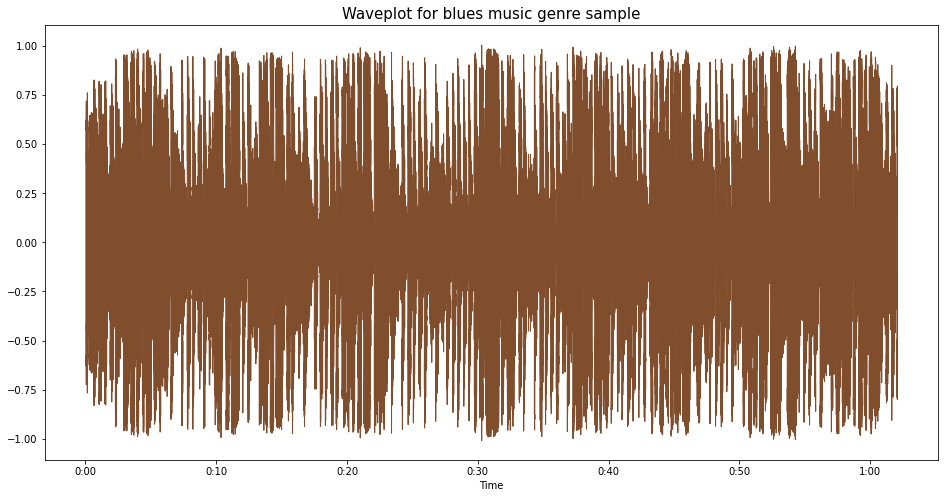

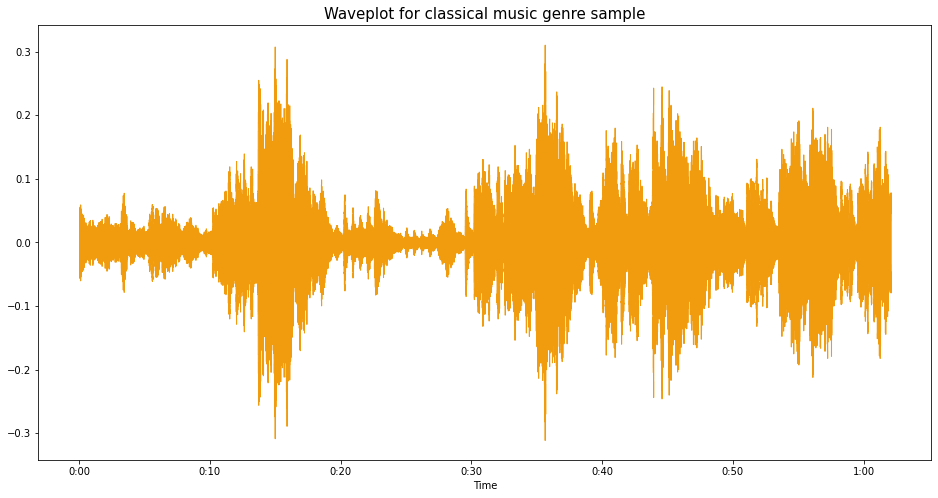

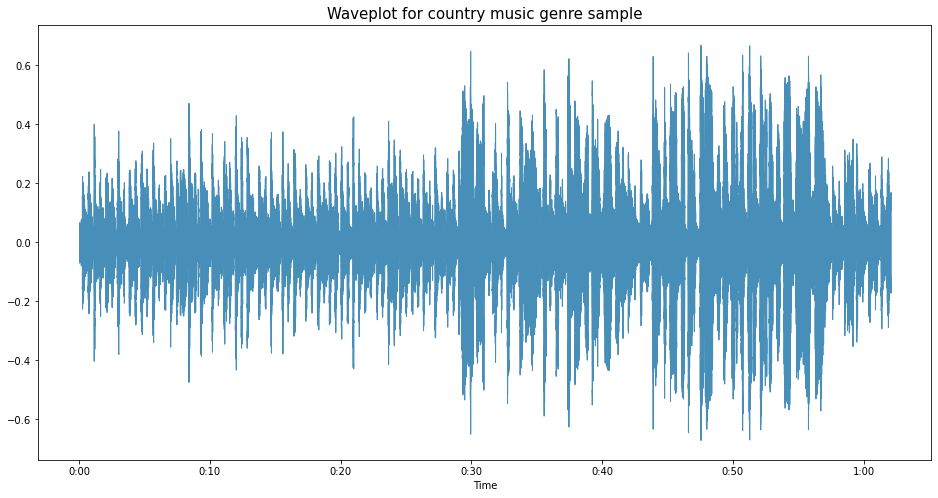

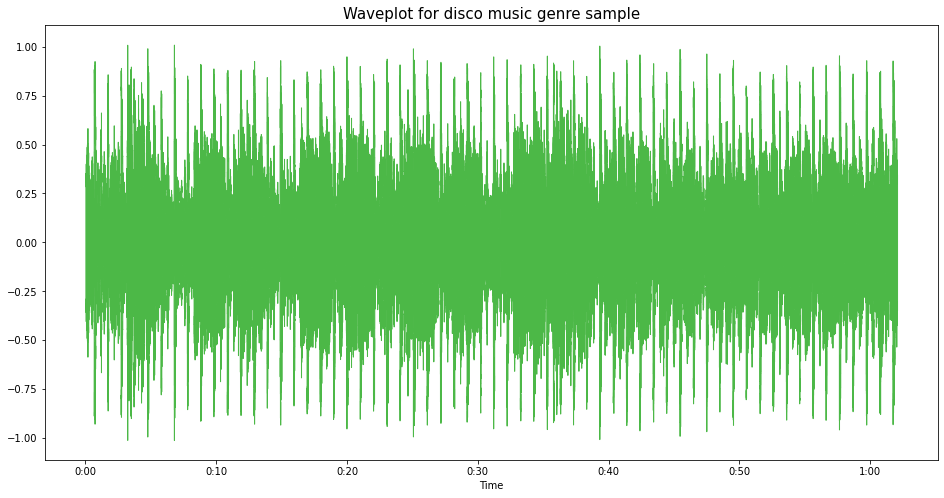

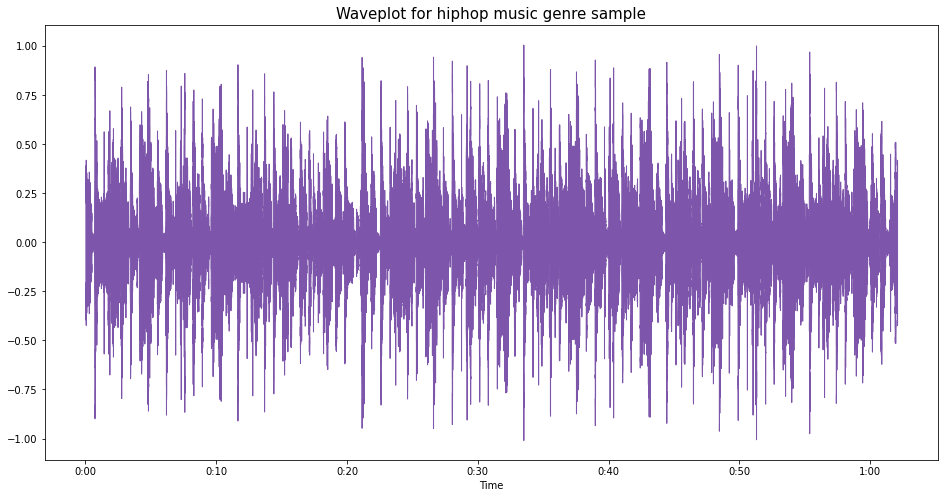

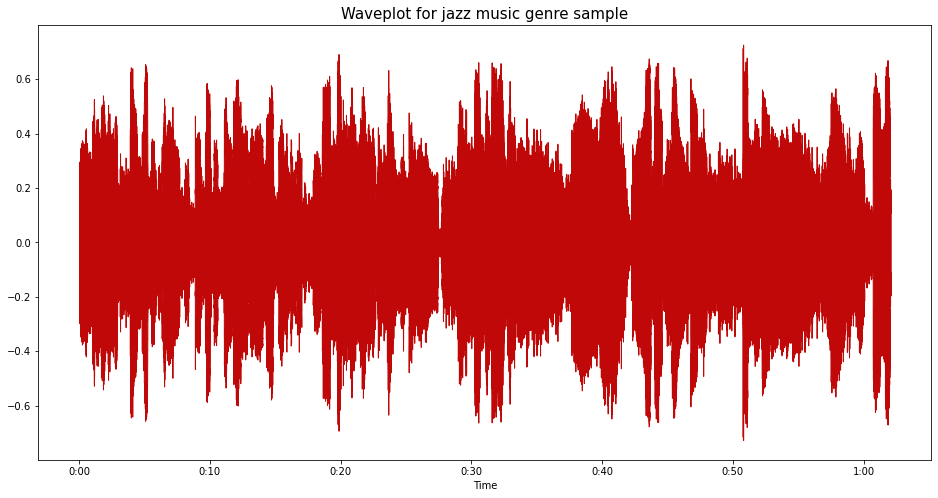

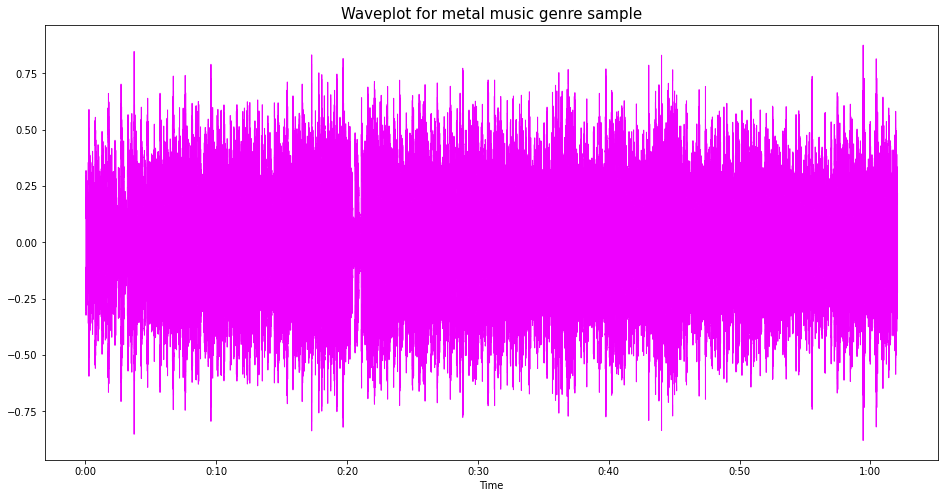

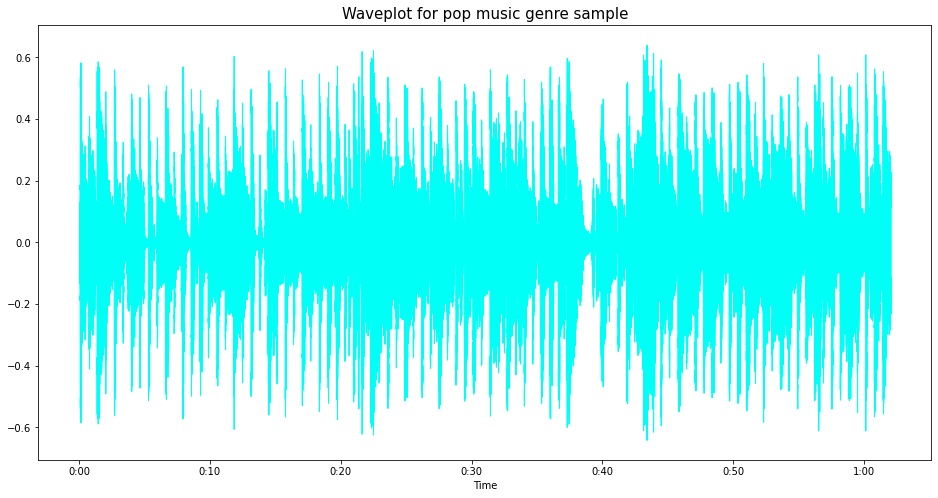

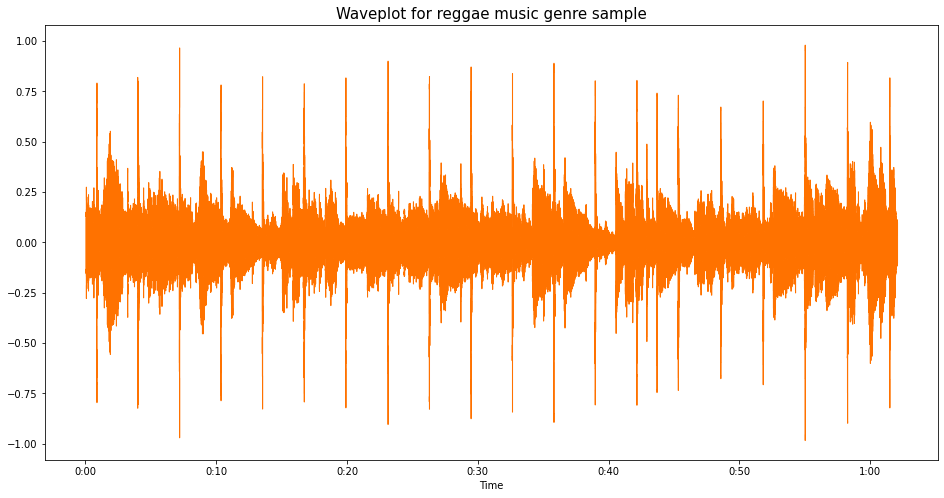

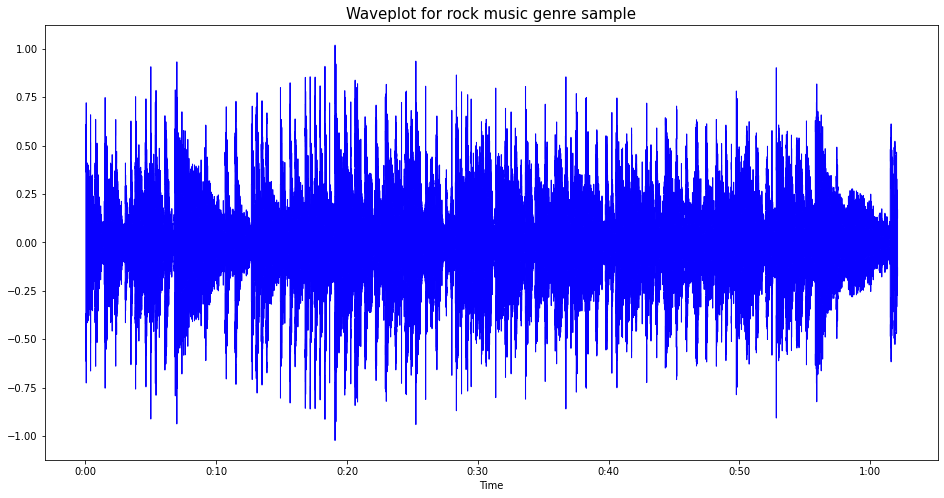

In [20]:
for audio in audios.keys():
    plt.figure(figsize=(16,8))
    plt.title(f'Waveplot for {audio} music genre sample',size=15)
    librosa.display.waveshow(audios[audio],color=colors[audio])
    print('\n')
    plt.show()

<a id="6"></a>
### Short-Time Fourier Transform Plots

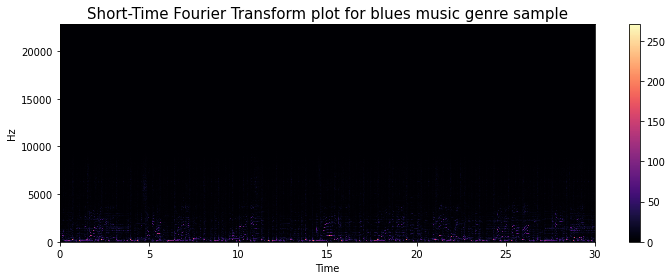

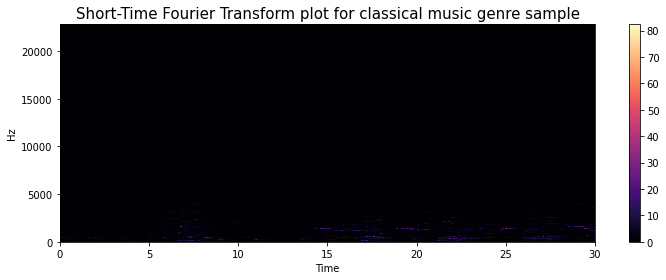

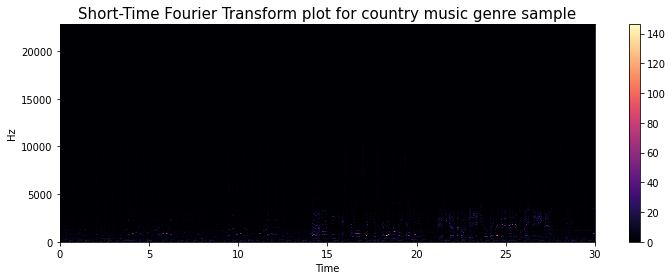

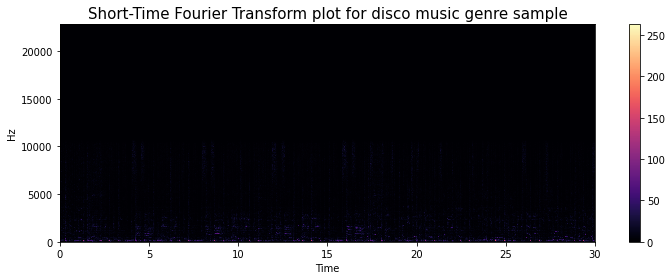

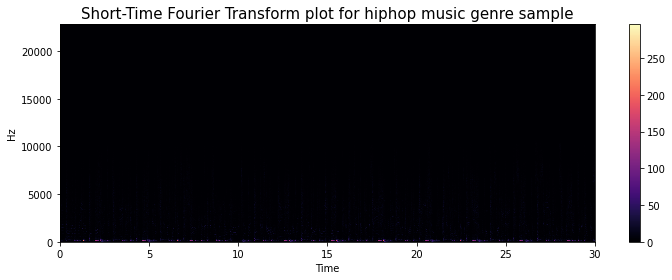

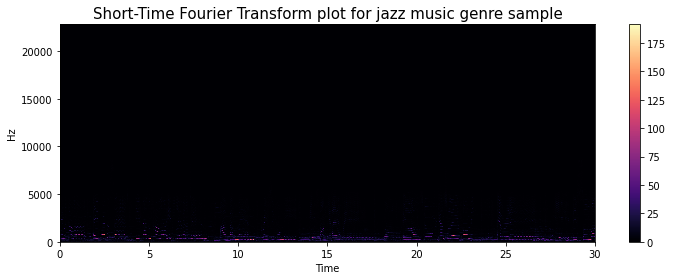

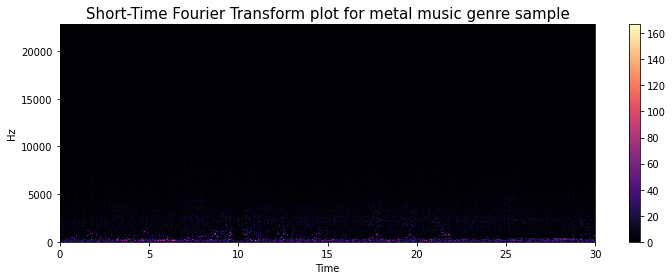

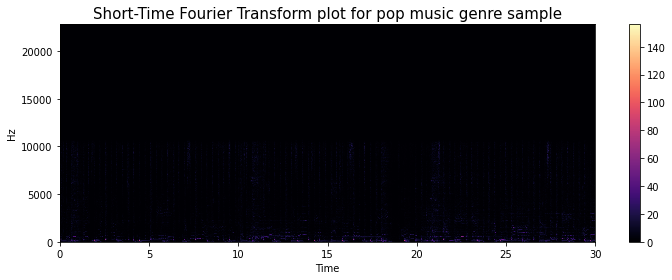

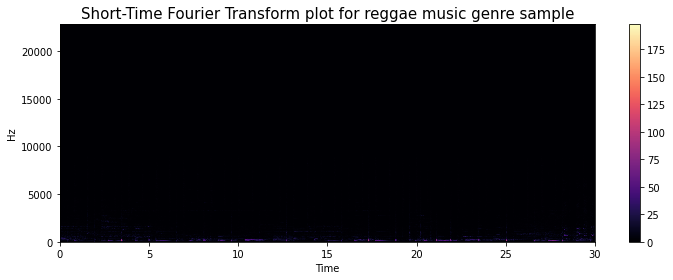

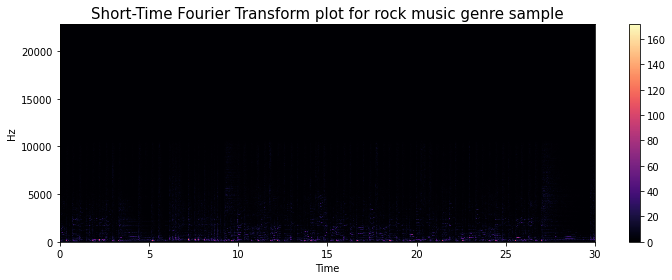

In [21]:
for audio in zip(audios.keys(),sample_rates.keys()):
    stft=librosa.stft(audios[audio[0]])
    plt.figure(figsize=(12,4))
    plt.title(f'Short-Time Fourier Transform plot for {audio[0]} music genre sample',size=15)
    librosa.display.specshow(stft,sr=sample_rates[audio[1]],x_axis='time',y_axis='hz')
    plt.colorbar()

<a id="7"></a>
### Spectograms

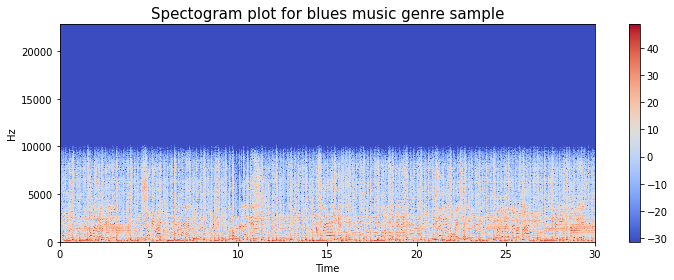

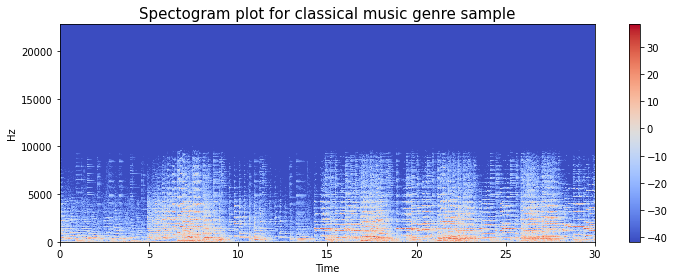

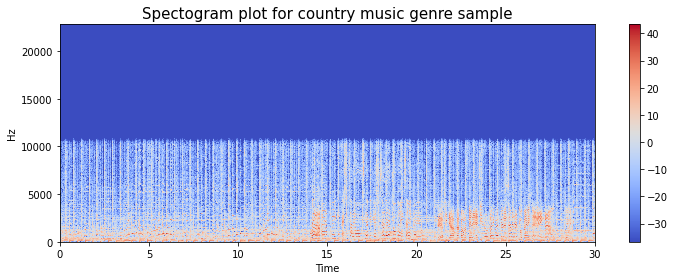

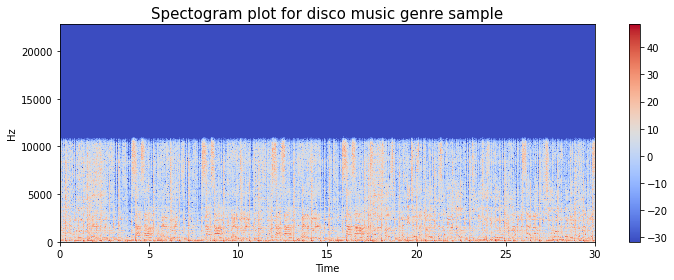

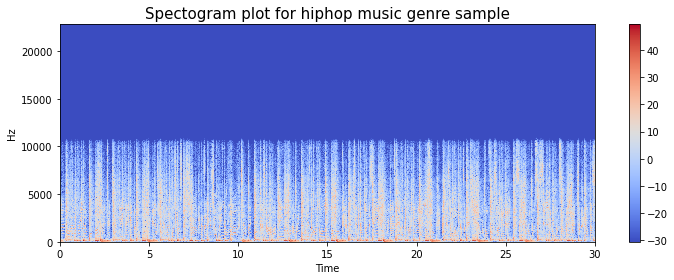

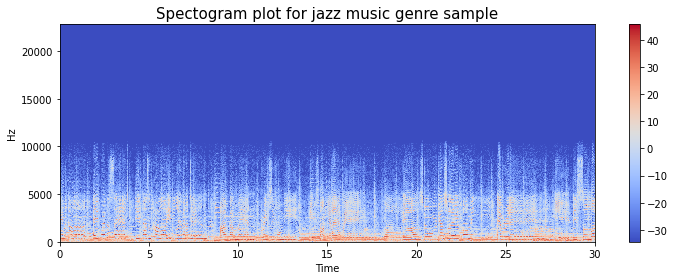

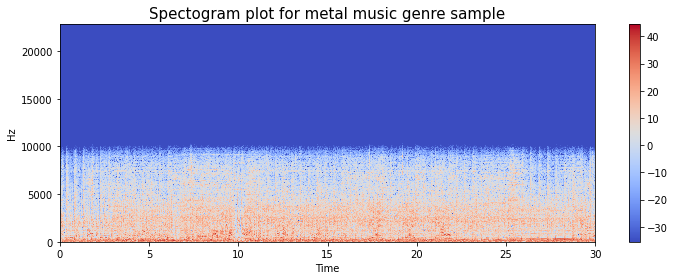

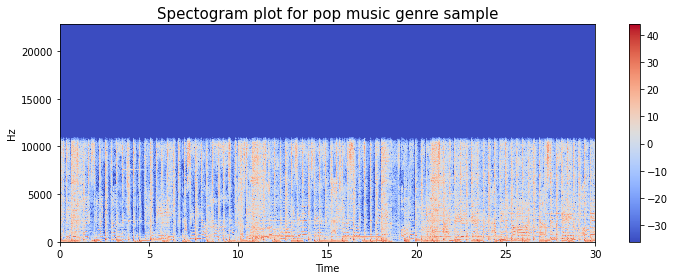

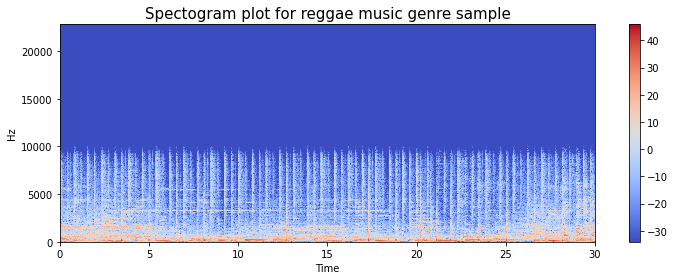

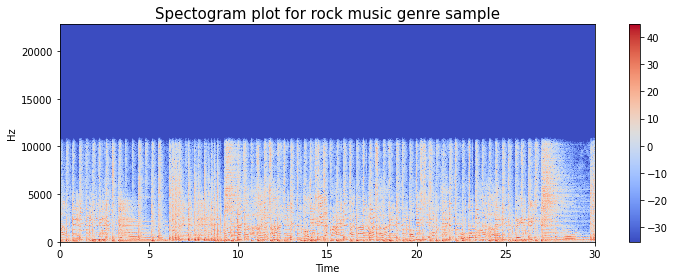

In [22]:
for audio in zip(audios.keys(),sample_rates.keys()):
    stft=librosa.stft(audios[audio[0]])
    stft_db=librosa.amplitude_to_db(abs(stft))
    plt.figure(figsize=(12,4))
    plt.title(f'Spectogram plot for {audio[0]} music genre sample',size=15)
    librosa.display.specshow(stft_db,sr=sample_rates[audio[1]],x_axis='time',y_axis='hz')
    plt.colorbar()

<a id="8"></a>
### Spectral Rolloff Plots

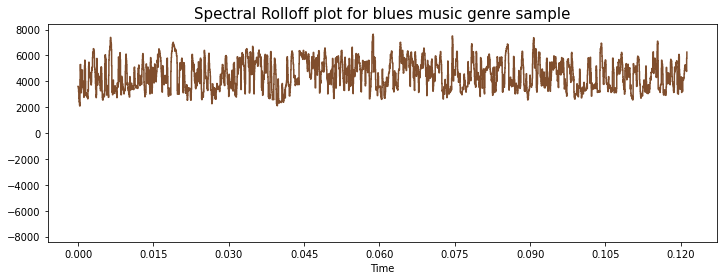

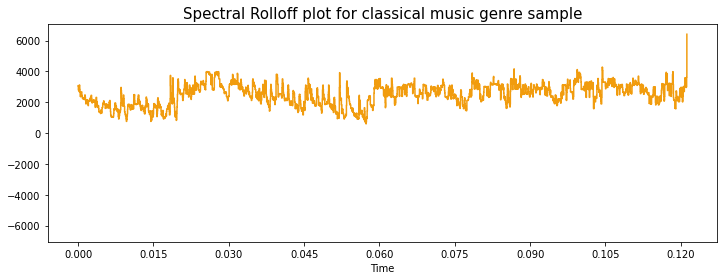

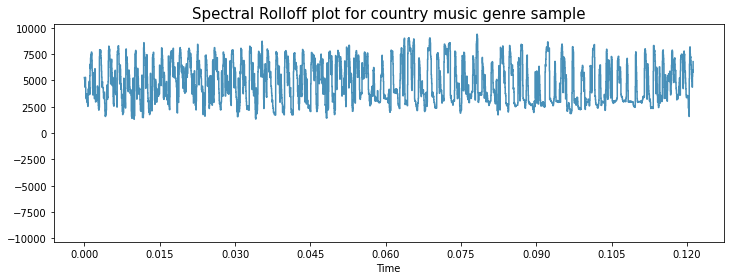

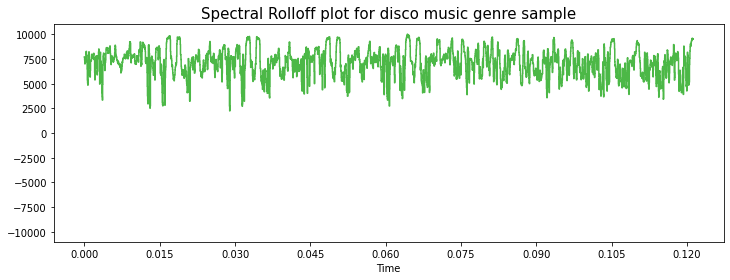

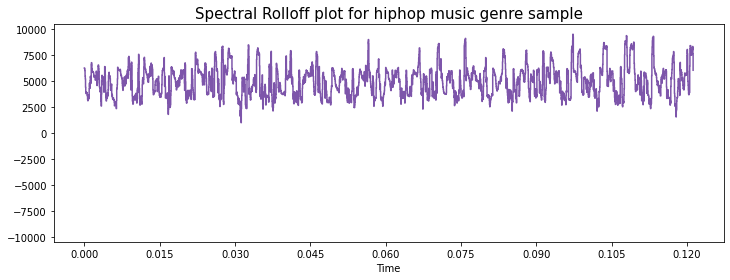

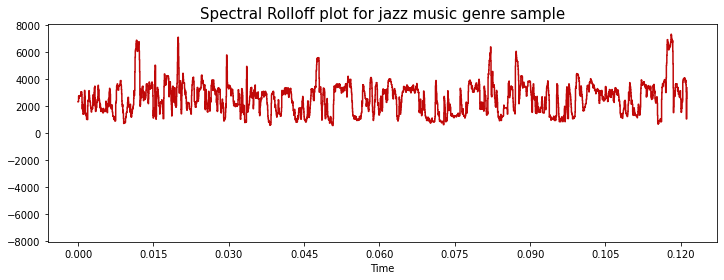

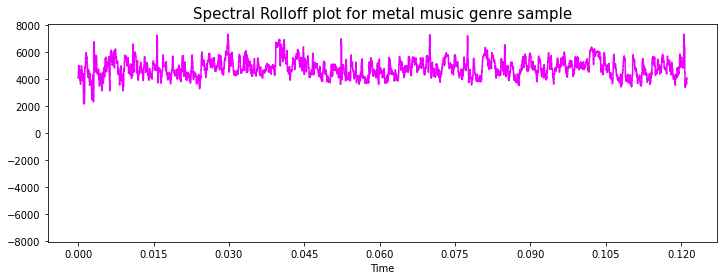

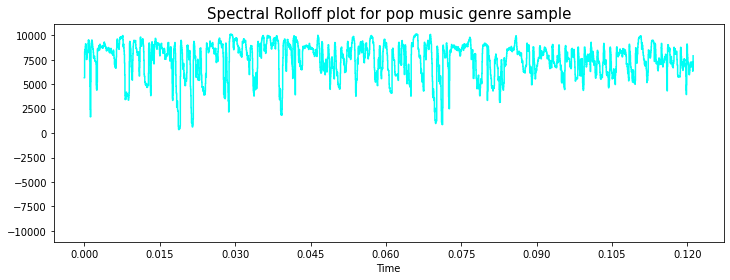

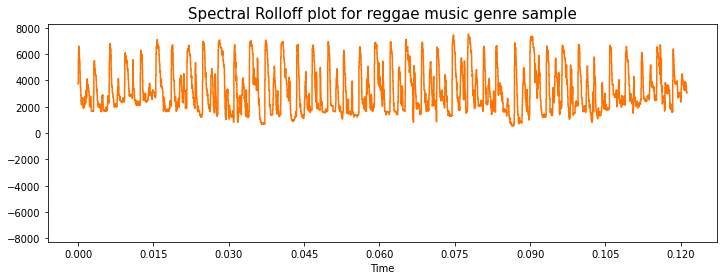

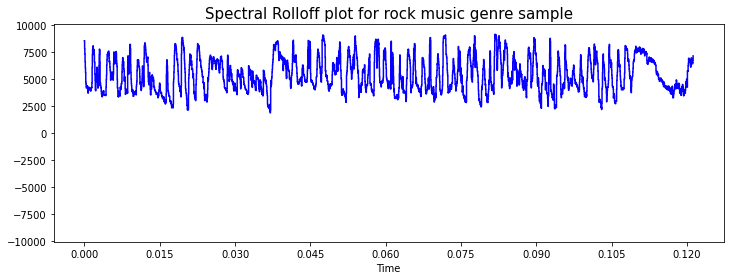

In [23]:
for audio in zip(audios.keys(),sample_rates.keys()):
    spectral_rolloff=librosa.feature.spectral_rolloff(audios[audio[0]]+0.01,sr=sample_rates[audio[1]])[0]
    plt.figure(figsize=(12,4))
    plt.title(f'Spectral Rolloff plot for {audio[0]} music genre sample',size=15)
    librosa.display.waveshow(spectral_rolloff,color=colors[audio[0]])
    plt.show()

In [24]:
color_maps={'blues':'PiYG',
        'classical':'PRGn',
        'country':'BrBG',
        'disco':'PuOr',
        'hiphop':'RdGy',
        'jazz':'RdBu',
        'metal':'RdYlBu',
        'pop':'RdYlGn',
        'reggae':'Spectral',
        'rock':'coolwarm'
       }


### PCA and Plotting

In [25]:
df_=df.iloc[0:,1:]
X=df_.loc[:,df_.columns!='label']
y=df_['label']
cols=X.columns
normalize=MinMaxScaler()
normalized_data=normalize.fit_transform(X)
X=pd.DataFrame(normalized_data,columns=cols)

pca=PCA(n_components=2)
principal_components=pca.fit_transform(X)
principal_df=pd.DataFrame(principal_components,columns=['pc1','pc2'])

f_df=pd.concat([principal_df,y],axis=1)

fig=px.scatter(f_df,x='pc1',
               y='pc2',
               color='label',
               symbol='label',
               title='Principal Component Analysis for Genres',
               labels={'pc1':'Principal Component 1','pc2':'Principal Component 2','label':'Genres'},
               width=1000,
               height=600
               )
fig.update_layout(title_x=0.5,font=dict(family='Arial, monospace',
                                       size=18,
                                       color='#6227D7',))
fig.show()

In [26]:
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


<a id="12"></a>
# Preparing Data for Training

In [27]:
f_df=df.drop(labels='filename',axis=1)
f_df.head()

,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues


<a id="13"></a>
## Label Encoding

In [28]:
le=LabelEncoder()
labels=f_df.iloc[:,-1]
y=le.fit_transform(labels)
scaler=StandardScaler()
X=scaler.fit_transform(np.array(f_df.iloc[:,:-1],dtype=float))

In [29]:
y

array([0, 0, 0, ..., 9, 9, 9])

<a id="14"></a>
## Train, Test Splitting

In [30]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25,random_state=42)

In [31]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(7492, 58)
(7492,)
(2498, 58)
(2498,)


<a id="15"></a>
## Correlation Heatmap

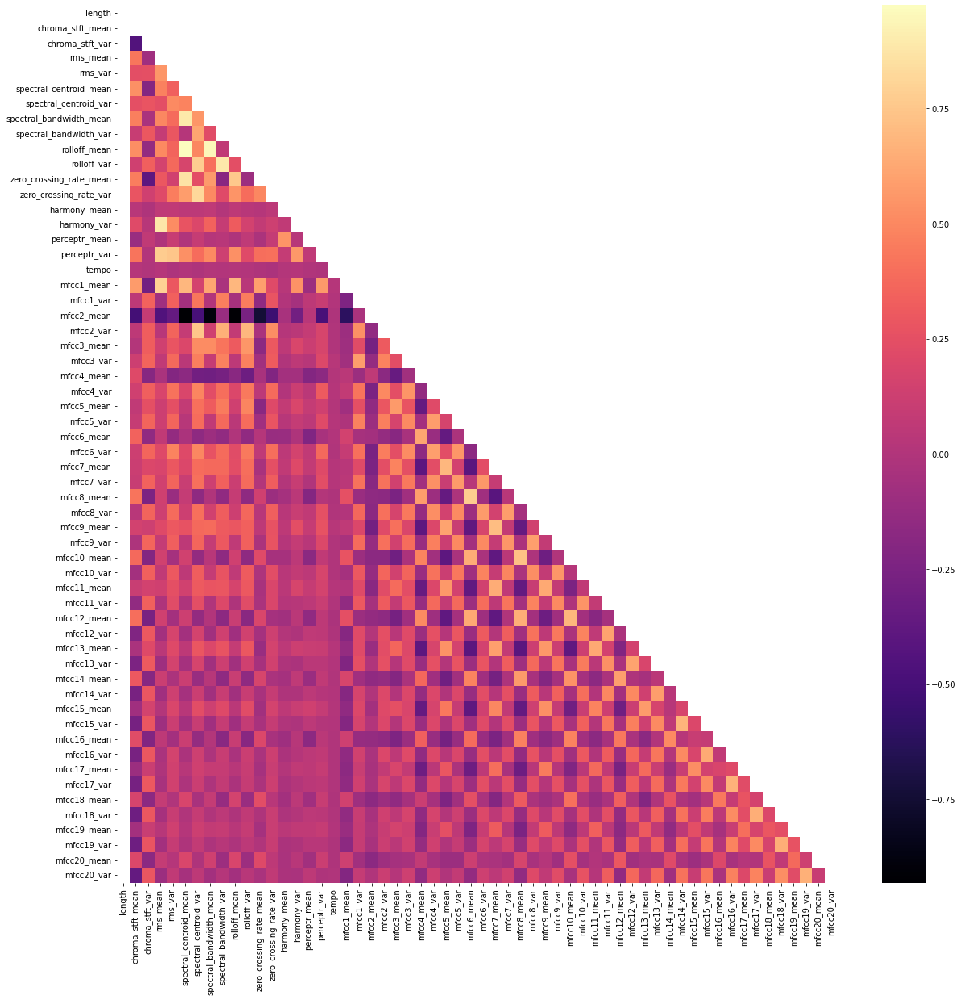

In [32]:
correlation=f_df.corr()
mask=np.zeros_like(correlation)
mask[np.triu_indices_from(mask)]=True
plt.subplots(figsize=(20,20))
sns.heatmap(correlation,mask=mask,cmap='magma')
plt.show()

<a id="16"></a>
# Preparing and Training Ensemble Models

In [33]:
random_state=42
classifier=[
            DecisionTreeClassifier(random_state=random_state),
            SVC(random_state=random_state,probability=True),
            RandomForestClassifier(random_state=random_state),
            LogisticRegression(random_state=random_state,solver='liblinear'),
            KNeighborsClassifier(),
            GaussianNB(),
            AdaBoostClassifier(random_state=random_state),
            XGBClassifier(learning_rate=0.02,n_estimators=1000,objective='binary:logistic',nthread=1,min_child_weight=5,subsample=0.8,colsample_bytree=0.8,max_depth=4),
            CatBoostClassifier(iterations=2500,depth=3,loss_function='MultiClass', leaf_estimation_iterations = 10,silent=True)
           ]
dt_param_grid={
        'min_samples_split':range(10,500,20),
        'max_depth':range(1,20,2)
}
svc_param_grid={
    'kernel':['rbf'],
    'gamma':[0.001,0.01,0.1,1],
    'C':[1,10,50,100,200,300,1000]
}
rf_param_grid={
    'max_features':[1,3,10],
    'min_samples_split':[2,3,10],
    'min_samples_leaf':[1,3,10],
    'bootstrap':[False],
    'n_estimators':[100,300],
    'criterion':['gini']
}
logreg_param_grid={
    'C':np.logspace(-3,3,7),
    'penalty':['l1','l2']
}
knn_param_grid={
    'n_neighbors':np.linspace(1,20,10,dtype=int).tolist(),
    'weights':['uniform','distance'],
    'metric':['eulidean','manhattan']
}
nb_param_grid={
    'var_smoothing':np.logspace(0,-9,num=100)
}

adaboost_param_grid={
    'n_estimators':[1,2,3,4,5,6,7,8,9,10,11,12,20,30]
}
xgb_param_grid={
    'gamma': [0.5, 1]
}
catboost_param_grid={
   'l2_leaf_reg':[1, 3, 5]
}
classifier_params=[
        dt_param_grid,
        svc_param_grid,
        rf_param_grid,
        logreg_param_grid,
        knn_param_grid,
        nb_param_grid,
        adaboost_param_grid,
        xgb_param_grid,
        catboost_param_grid
]

In [34]:
def plot_cm(model,y_true,y_pred):
    conf=confusion_matrix(y_true,y_pred)
    cm=pd.DataFrame(
        conf,index=[i for i in genres],
        columns=[i for i in genres]
    )
    plt.figure(figsize=(12,7))
    ax=sns.heatmap(cm,annot=True,fmt='d')
    ax.set_title(f'Confusion Matrix for {model} ')
    plt.show()
    print(classification_report(y_true,y_pred,target_names=genres))

<a id="17"></a>
## Training and Results

In [ ]:
cv_result=[]
best_estimator=[]
result_name=[
             'Decision Tree Classifier accuracy: ',
             'Support Vector Machine Classifier accuracy: ', 
             'Random Forest Classifier accuracy: ', 
             'Logistic Regression Classifier accuracy: ', 
             'KNN Classifier accuracy: ',
             'Gaussian Naive Bayes Classifier accuracy: ',
             'Ada Boost Classifier accuracy: ',
             'X Gradient Boost Classifier accuracy: ',
             'Cat Boost Classifier accuracy: '
            ]

for i in range(len(classifier)):
    clf=GridSearchCV(classifier[i],param_grid=classifier_params[i],cv=StratifiedKFold(n_splits=10),scoring='accuracy',n_jobs=-1,verbose=1)
    clf.fit(X_train,y_train)
    y_pred=clf.predict(X_test)
    cv_result.append(clf.best_score_)
    best_estimator.append(clf.best_estimator_)
    print(f'{result_name[i]}{cv_result[i]}\n')
    plot_cm(result_name[i][:-11],y_test,y_pred)

Fitting 10 folds for each of 250 candidates, totalling 2500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:    8.3s
[Parallel(n_jobs=-1)]: Done 442 tasks      | elapsed:   23.6s
[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed:   59.3s


<a id="18"></a>
## Training Results on Test Dataset

In [ ]:
cv_results=pd.DataFrame({'Cross Validation Means':cv_result, 'ML Models':['DecisionTreeClassifier',
                                                                          'SVM',
                                                                          'RandomForestClassifier',
                                                                          'LogisticRegression',
                                                                          'KNeighborsClassifier',
                                                                          'GaussianNB',
                                                                          'AdaBoostClassifier',
                                                                          'XGBClassifier',
                                                                          'CatBoostClassifier']})
g=sns.barplot('Cross Validation Means', 'ML Models', data=cv_results)
g.set_xlabel('Mean Accuracy')
g.set_title('Cross Validation Scores')
plt.show()

In [ ]:
 if not os.path.exists('models'):
    os.makedirs('models')

* Models with greater than 80 percent accuracy:
    * Support Vector Machine
    * Random Forest Classifier
    * K-Nearest Neighbor
    * Cross Gradient Boosting
    * Cat Boost Classifier
* now we are going to combine. We expect the best model to be more accurate from ensemble model

<a id="19"></a>
## Ensemble Learning with Models with Greater Than 80 percent Accuracy Score

In [ ]:
voting_c=VotingClassifier(estimators=[('svm',best_estimator[1]),
                                     ('rfc',best_estimator[2]),
                                     ('knn',best_estimator[4]),
                                     ('xgb',best_estimator[7]),
                                     ('cbc',best_estimator[8])],
                                     voting='soft',n_jobs=-1)
voting_c=voting_c.fit(X_train,y_train)
y_prediction=voting_c.predict(X_test)
plot_cm('Ensemble Learning',y_test,y_prediction)

* As we can see ensemble model has more accurate predictions according to single the best model.

In [ ]:
#joblib.dump(voting_c,'models/Ensemble_model.pkl')

<a id="20"></a>
# Recommendation

<a id="21"></a>
## Including Dataset for Recommendation

In [ ]:
recommend_data=pd.read_csv(f'{GENERAL_PATH}/features_30_sec.csv',index_col='filename')
recommend_data.head(10)

<a id="22"></a>
## Preparing Data for Recommendation

In [ ]:
r_labels=recommend_data[['label']]
recommend_data=recommend_data.drop(columns=['length','label'])
recommend_data.head()

In [ ]:
scaled_data=preprocessing.scale(recommend_data)
print('Scaled data type:', type(scaled_data))

<a id="23"></a>
## Finding Similarity

In [ ]:
similarity=cosine_similarity(scaled_data)

In [ ]:
similarity_df=pd.DataFrame(similarity)
similarity_df_names=similarity_df.set_index(r_labels.index)
similarity_df_names.columns=r_labels.index
similarity_df_names.head()

In [ ]:
def find_similar_music(music):
    song=similarity_df_names[music].sort_values(ascending=False)
    song=song.drop(music)
    print(song.head(5),'\n')

In [ ]:
visualize_audio_path

In [ ]:
for i in visualize_audio_path.items():
    find_similar_music(i[1])

<a id="24"></a>
## Recommended Music for Each Genre

In [ ]:
print('Original Music for Blues Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/blues/blues.00077.wav')

In [ ]:
print('Recommended Music for Blues Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/blues/blues.00078.wav')

* Blues recommendation is true

In [ ]:
print('Original Music for Classical Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/classical/classical.00010.wav')

In [ ]:
print('Recommended Music for Classical Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/classical/classical.00073.wav')

* Classical recommendation is true

In [ ]:
print('Original Music for Country Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/country/country.00034.wav')

In [ ]:
print('Recommended Music for Country Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/reggae/reggae.00058.wav')

* County recommendation is false 

In [ ]:
print('Original Music for Disco Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/disco/disco.00028.wav')

In [ ]:
print('Recommended Music for Disco Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/disco/disco.00035.wav')

* Disco recommendation is true

In [ ]:
print('Original Music for Hiphop Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/hiphop/hiphop.00058.wav')

In [ ]:
print('Recommended Music for Hiphop Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/reggae/reggae.00079.wav')

* Hiphop recommendation is false

In [ ]:
print('Original Music for Jazz Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/jazz/jazz.00067.wav')

In [ ]:
print('Recommended Music for Jazz Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/jazz/jazz.00040.wav')

* Jazz recommendation is true

In [ ]:
print('Original Music for Metal Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/metal/metal.00027.wav')

In [ ]:
print('Recommended Music for Metal Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/metal/metal.00020.wav')

* Metal recommendation is true

In [ ]:
print('Original Music for Pop Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/pop/pop.00032.wav')

In [ ]:
print('Recommended Music for Pop Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/pop/pop.00023.wav')

* Pop recommendation is true

In [ ]:
print('Original Music for Reggae Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/reggae/reggae.00001.wav')

In [ ]:
print('Recommended Music for Reggae Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/blues/blues.00035.wav')

* Reggae recommendation is false

In [ ]:
print('Original Music for Rock Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/rock/rock.00042.wav')

In [ ]:
print('Recommended Music for Rock Genre\n')
Audio(f'{GENERAL_PATH}/genres_original/disco/disco.00030.wav')

* Rock recommendation is false

* Cosine Similarity model can correct recommendation with a rate of 6/10. This is not bad.

<a id="25"></a>
# Generation

In [ ]:
epochs = 30
latent_dim = 2
num_examples_to_generate = 10

<a id="26"></a>
## Loading Dataset and Creating Variational Autoencoder Model

In [ ]:
def load_dataset(genre):
    music_list = np.array(sorted(os.listdir(f'{GENERAL_PATH}/genres_original/{genre}')))
    music_list_c=list(music_list[[0,52,19,39,71,12,75,85,3,45,24,46,88]])
    music_list2_c=list(music_list[[4,43,56,55,45,31,11,13,70,37,21,78]])
    music_list_path = [f'{GENERAL_PATH}/genres_original/{genre}/{x}' for x in music_list_c]
    music_list_path2 = [f'{GENERAL_PATH}/genres_original/{genre}/{x}' for x in music_list2_c]
    return music_list_path, music_list_path2

In [ ]:
def load_file(file):
    data, sr = librosa.load(file,sr=3000, offset=0.0, duration=30)
    data = data.reshape(1,90001)
    return data
datas = lambda filename: tf.compat.v1.py_func(load_file, [filename], [tf.float32])

In [ ]:
music_list,music_list2=load_dataset('pop')

In [ ]:
train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((music_list))
    .map(datas, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .shuffle(3)
    .batch(10)
)
test_dataset = (
    tf.data.Dataset
    .from_tensor_slices((music_list2))
    .map(datas, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .shuffle(3)
    .batch(10)
)

In [ ]:
class Resnet1DBlock(tf.keras.Model):
    def __init__(self, kernel_size, filters,type='encode'):
        super(Resnet1DBlock, self).__init__(name='')
    
        if type=='encode':
            self.conv1a = L.Conv1D(filters, kernel_size, 2,padding="same")
            self.conv1b = L.Conv1D(filters, kernel_size, 1,padding="same")
            self.norm1a = tfa.layers.InstanceNormalization()
            self.norm1b = tfa.layers.InstanceNormalization()
        if type=='decode':
            self.conv1a = L.Conv1DTranspose(filters, kernel_size, 1,padding="same")
            self.conv1b = L.Conv1DTranspose(filters, kernel_size, 1,padding="same")
            self.norm1a = L.BatchNormalization()
            self.norm1b = L.BatchNormalization()
        else:
            return None

    def call(self, input_tensor):
        x = tf.nn.relu(input_tensor)
        x = self.conv1a(x)
        x = self.norm1a(x)
        x = L.LeakyReLU(0.4)(x)

        x = self.conv1b(x)
        x = self.norm1b(x)
        x = L.LeakyReLU(0.4)(x)

        x += input_tensor
        return tf.nn.relu(x)

In [ ]:
class CVAE(tf.keras.Model):
    def __init__(self, latent_dim):
        super(CVAE, self).__init__()
        self.latent_dim = latent_dim
        self.encoder = tf.keras.Sequential(
            [
                L.InputLayer(input_shape=(1,90001)),
                L.Conv1D(64,1,2),
                Resnet1DBlock(64,1),
                L.Conv1D(128,1,2),
                Resnet1DBlock(128,1),
                L.Conv1D(128,1,2),
                Resnet1DBlock(128,1),
                L.Conv1D(256,1,2),
                Resnet1DBlock(256,1),
                L.Flatten(),
                L.Dense(latent_dim+latent_dim)

            ]
        )
        self.decoder = tf.keras.Sequential(
            [
                L.InputLayer(input_shape=(latent_dim,)),
                L.Reshape(target_shape=(1,latent_dim)),
                Resnet1DBlock(512,1,'decode'),
                L.Conv1DTranspose(512,1,1),
                Resnet1DBlock(256,1,'decode'),
                L.Conv1DTranspose(256,1,1),
                Resnet1DBlock(128,1,'decode'),
                L.Conv1DTranspose(128,1,1),
                Resnet1DBlock(64,1,'decode'),
                L.Conv1DTranspose(64,1,1),
                L.Conv1DTranspose(90001,1,1),
            ]
        )
    @tf.function
    def sample(self, eps=None):
        if eps is None:
            eps = tf.random.normal(shape=(200, self.latent_dim))
        return self.decode(eps, apply_sigmoid=True)
    @tf.function
    def encode(self, x):
        mean, logvar = tf.split(self.encoder(x), num_or_size_splits=2, axis=1)
        return mean, logvar
    @tf.function
    def reparameterize(self, mean, logvar):
        eps = tf.random.normal(shape=mean.shape)
        return eps * tf.exp(logvar * .5) + mean
    @tf.function
    def decode(self, z, apply_sigmoid=False):
        logits = self.decoder(z)
        if apply_sigmoid:
            probs = tf.sigmoid(logits)
            return probs
        return logits
optimizer = tf.keras.optimizers.Adam(0.0002,beta_1=0.9, beta_2=0.999,epsilon=1e-08)

In [ ]:
@tf.function
def log_normal_pdf(sample, mean, logvar, raxis=1):
    log2pi = tf.math.log(2. * np.pi)
    return tf.reduce_sum(
         -.5 * ((sample - mean) ** 2. * tf.exp(-logvar) + logvar + log2pi),
          axis=raxis)
@tf.function
def compute_loss(model, x):
    mean, logvar = model.encode(x)
    z = model.reparameterize(mean, logvar)
    x_logit = model.decode(z)
    cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=x_logit, labels=x)
    logpx_z = -tf.reduce_sum(cross_ent, axis=[1,2])
    logpz = log_normal_pdf(z, 0., 0.)
    logqz_x = log_normal_pdf(z, mean, logvar)
    return -tf.reduce_mean(logpx_z + logpz - logqz_x)

In [ ]:
@tf.function
def train_step(model, x, optimizer):
    with tf.GradientTape() as tape:
            mean, logvar = model.encode(x)
            z = model.reparameterize(mean, logvar)
            x_logit = model.decode(z)
            cross_ent = tf.nn.sigmoid_cross_entropy_with_logits(logits=x_logit, labels=x)
            logpx_z = -tf.reduce_sum(cross_ent, axis=[1,2])
            logpz = log_normal_pdf(z, 0., 0.)
            logqz_x = log_normal_pdf(z, mean, logvar)
            loss_KL = -tf.reduce_mean(logpx_z + logpz - logqz_x)
            reconstruction_loss = tf.reduce_mean(
                     tf.keras.losses.binary_crossentropy(x, x_logit)
                 )
            total_loss = reconstruction_loss+ loss_KL
    gradients = tape.gradient(total_loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
random_vector_for_generation = tf.random.normal(
    shape=[num_examples_to_generate, latent_dim])
model = CVAE(latent_dim)

<a id="27"></a>
## Training

In [ ]:
def train(train_dataset, test_dataset, model, save):
    for epoch in range(1, epochs + 1):
        start_time = time.time()
        for train_x in train_dataset:
            train_x = np.asarray(train_x)[0]
            train_step(model, train_x, optimizer)
        end_time = time.time()

        loss = tf.keras.metrics.Mean()
        for test_x in test_dataset:
            test_x = np.asarray(test_x)[0]
            loss(compute_loss(model, test_x))
        elbo = -loss.result()
        print(f'Epoch: {epoch}, Test set ELBO: {elbo}, time elapse for current epoch: {end_time - start_time}')
train(train_dataset, test_dataset, model, 'pop')

<a id="28"></a>
## Results

In [ ]:
def inference(test_dataset, model):  
    save_music = []
    for test in test_dataset:
        mean, logvar = model.encode(test)
        z = model.reparameterize(mean, logvar)
        predictions = model.sample(z)
        for pred in predictions:
            wave = np.asarray(pred)
            save_music.append(wave)
    return save_music

saved_musics = inference(test_dataset, model)

In [ ]:
music1=saved_musics[0][0]
Audio(music1,rate=3000)

In [ ]:
music2=saved_musics[11][0]
Audio(music2,rate=3000)